In [1]:
# to get an idea of a simple problem formulation and dataprocessing, I am following a guide for the Credit Risk Problem found here: https://www.kaggle.com/willkoehrsen/start-here-a-gentle-introduction
# I'll be using this as a guide towards more complex problem forumation using all of the .csv files provided

import pandas as pd
import numpy as np
import xgboost as xgb

# sklearn preprocessing for dealing with categorical variables
from sklearn.preprocessing import LabelEncoder

import matplotlib.pyplot as plt
import seaborn as sns

#suppress warnings
import warnings
warnings.filterwarnings('ignore')


#formatting for plots 
SMALL_SIZE = 10
MEDIUM_SIZE = 12

plt.rc('font', size = SMALL_SIZE)
plt.rc('axes', titlesize = MEDIUM_SIZE)
plt.rc('axes', labelsize = MEDIUM_SIZE)
plt.rcParams['figure.dpi'] = 150


In [2]:
#importing training data 
from pathlib import Path

#note chunksize can be used in a loop to perform operations on all rows if needed
#cred_risk = pd.rFead_csv(path_in, chunksize = 3000, iterator= True)

path_in = 'Data/application_train.csv'

#reading in training data
cred_risk_train = pd.read_csv(path_in)
cred_risk_train.info()

#reading in testing data (not simlar cols as train (missing TARGET), and fewer rows)
cred_risk_test = pd.read_csv('Data/application_test.csv')

#prints name of each col as list
print('\n', cred_risk_train.columns.values) 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB

 ['SK_ID_CURR' 'TARGET' 'NAME_CONTRACT_TYPE' 'CODE_GENDER' 'FLAG_OWN_CAR'
 'FLAG_OWN_REALTY' 'CNT_CHILDREN' 'AMT_INCOME_TOTAL' 'AMT_CREDIT'
 'AMT_ANNUITY' 'AMT_GOODS_PRICE' 'NAME_TYPE_SUITE' 'NAME_INCOME_TYPE'
 'NAME_EDUCATION_TYPE' 'NAME_FAMILY_STATUS' 'NAME_HOUSING_TYPE'
 'REGION_POPULATION_RELATIVE' 'DAYS_BIRTH' 'DAYS_EMPLOYED'
 'DAYS_REGISTRATION' 'DAYS_ID_PUBLISH' 'OWN_CAR_AGE' 'FLAG_MOBIL'
 'FLAG_EMP_PHONE' 'FLAG_WORK_PHONE' 'FLAG_CONT_MOBILE' 'FLAG_PHONE'
 'FLAG_EMAIL' 'OCCUPATION_TYPE' 'CNT_FAM_MEMBERS' 'REGION_RATING_CLIENT'
 'REGION_RATING_CLIENT_W_CITY' 'WEEKDAY_APPR_PROCESS_START'
 'HOUR_APPR_PROCESS_START' 'REG_REGION_NOT_LIVE_REGION'
 'REG_REGION_NOT_WORK_REGION' 'LIVE_REGION_NOT_WORK_REGION'
 'REG_CITY_NOT_LIVE_CITY' 'REG_CITY_NOT_WORK_CITY'
 'LIVE_CITY_NOT_WORK_CIT

In [3]:
print('Training Data Shape: ', cred_risk_train.shape)

cred_risk_train.describe()


Training Data Shape:  (307511, 122)


,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,...,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,...,0.008130,0.000595,0.000507,0.000335,0.006402,0.007000,0.034362,0.267395,0.265474,1.899974
std,102790.175348,0.272419,0.722121,2.371231e+05,4.024908e+05,14493.737315,3.694465e+05,0.013831,4363.988632,141275.766519,...,0.089798,0.024387,0.022518,0.018299,0.083849,0.110757,0.204685,0.916002,0.794056,1.869295
min,100002.000000,0.000000,0.000000,2.565000e+04,4.500000e+04,1615.500000,4.050000e+04,0.000290,-25229.000000,-17912.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,189145.500000,0.000000,0.000000,1.125000e+05,2.700000e+05,16524.000000,2.385000e+05,0.010006,-19682.000000,-2760.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,278202.000000,0.000000,0.000000,1.471500e+05,5.135310e+05,24903.000000,4.500000e+05,0.018850,-15750.000000,-1213.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,367142.500000,0.000000,1.000000,2.025000e+05,8.086500e+05,34596.000000,6.795000e+05,0.028663,-12413.000000,-289.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000
max,456255.000000,1.000000,19.000000,1.170000e+08,4.050000e+06,258025.500000,4.050000e+06,0.072508,-7489.000000,365243.000000,...,1.000000,1.000000,1.000000,1.000000,4.000000,9.000000,8.000000,27.000000,261.000000,25.000000


In [4]:
#printing the head of the dataset
cred_risk_train.head()


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


#E#xamining the Distribution of the Target Column

Target is the variable that we will be predicting. This section will take a look at how they are distributed.

Note: predicting Target is a binary problem, that is either 0 (loan repaid on time) or 1 (loan not repaid on time). It will be a logistic regression problem.

In [5]:
cred_risk_train['TARGET'].value_counts()

0    282686
1     24825
Name: TARGET, dtype: int64

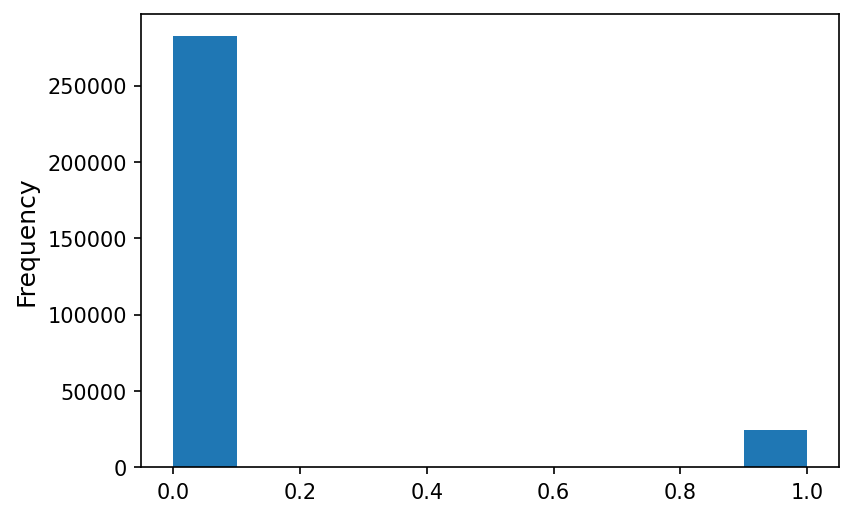

In [6]:
cred_risk_train['TARGET'].plot.hist()

From this information about the TARGET value distribution, we can see that this is an 'imbalanced class problem'. (i.e the total number of positive data (class) is far greater than total number of negative data (class)).

In a more sophisticated model, I can weight the classes to represent this imbalance.

In [7]:
# Function to examine missing values from dataset

def missing_values_table(df):
    #Total missing values
    mis_val = df.isnull().sum()

    #precentage missing values
    mis_val_percent = 100 * mis_val / len(df)
    #mis_val_percent = 100 * df.isnull().sum / len(df)
    
    #make table with results
    mis_val_table = pd.concat([mis_val, mis_val_percent], axis=1)

    #rename the columns
    mis_val_table_col_rename = mis_val_table.rename(columns = {0: 'Missing Values', 1: '% of Total Values'})

    #sort table by precentage of missing vals decending
    mis_val_table_col_rename = mis_val_table_col_rename[mis_val_table_col_rename.iloc[:,1]!=0].sort_values('% of Total Values', ascending = False).round(1)

    #print summary info
    print ("Your selected dataframe has " + str(df.shape[1]) + " columns.\n" +"There are " + str(mis_val_table_col_rename.shape[0]) + " columns that have missing values.")
        
    # Return the dataframe with missing information
    return mis_val_table_col_rename

In [8]:
#missing value statistics
#will need to fill in missing values later (imputation) or remove cols from dataset

missing_values = missing_values_table(cred_risk_train)
missing_values.head(30)

Your selected dataframe has 122 columns.
There are 67 columns that have missing values.


,Missing Values,% of Total Values
COMMONAREA_MEDI,214865,69.9
COMMONAREA_AVG,214865,69.9
COMMONAREA_MODE,214865,69.9
NONLIVINGAPARTMENTS_MEDI,213514,69.4
NONLIVINGAPARTMENTS_MODE,213514,69.4
NONLIVINGAPARTMENTS_AVG,213514,69.4
FONDKAPREMONT_MODE,210295,68.4
LIVINGAPARTMENTS_MODE,210199,68.4
LIVINGAPARTMENTS_MEDI,210199,68.4
LIVINGAPARTMENTS_AVG,210199,68.4


##Column types
Looking at columns

In [9]:
#number of each type of col
cred_risk_train.dtypes.value_counts()

#print('\n')


float64    65
int64      41
object     16
dtype: int64

In [10]:

#number of unique classes in each object column
cred_risk_train.select_dtypes('object').apply(pd.Series.nunique, axis=0)


NAME_CONTRACT_TYPE             2
CODE_GENDER                    3
FLAG_OWN_CAR                   2
FLAG_OWN_REALTY                2
NAME_TYPE_SUITE                7
NAME_INCOME_TYPE               8
NAME_EDUCATION_TYPE            5
NAME_FAMILY_STATUS             6
NAME_HOUSING_TYPE              6
OCCUPATION_TYPE               18
WEEKDAY_APPR_PROCESS_START     7
ORGANIZATION_TYPE             58
FONDKAPREMONT_MODE             4
HOUSETYPE_MODE                 3
WALLSMATERIAL_MODE             7
EMERGENCYSTATE_MODE            2
dtype: int64

##Encoding Categorical Values

Most ML models are unable to handle categorical (string, object) values. Therefore we must encode them to ints for processing. 

Two most common types of encoding are:
- label encoding: assigning each unique categorical label an integer
- one hot encoding: creating new columns, that have 1's where a category exisits and 0's otherwise

Note: Label encoding is fine for cols with two categories (otherwise model might arbitrarily order them). One hot encoding is better for cols with >2 categories.

In [11]:
# creating a label encoder

le = LabelEncoder()
le_count = 0

#iterate through cols
for col in cred_risk_train:
    print(col)
    if cred_risk_train[col].dtype == 'object':
        #if 2 or fewer unique categories
        if len(list(cred_risk_train[col].unique())) <= 2:
            # Train on training data
            le.fit(cred_risk_train[col])
            #Transforms both training and testing data
            cred_risk_train[col] = le.transform(cred_risk_train[col])
            cred_risk_test[col] = le.transform(cred_risk_test[col])

            #keep count of number of cols that are label encoded
            le_count += 1

print('%d columns were label encoded.' % le_count)

SK_ID_CURR
TARGET
NAME_CONTRACT_TYPE
CODE_GENDER
FLAG_OWN_CAR
FLAG_OWN_REALTY
CNT_CHILDREN
AMT_INCOME_TOTAL
AMT_CREDIT
AMT_ANNUITY
AMT_GOODS_PRICE
NAME_TYPE_SUITE
NAME_INCOME_TYPE
NAME_EDUCATION_TYPE
NAME_FAMILY_STATUS
NAME_HOUSING_TYPE
REGION_POPULATION_RELATIVE
DAYS_BIRTH
DAYS_EMPLOYED
DAYS_REGISTRATION
DAYS_ID_PUBLISH
OWN_CAR_AGE
FLAG_MOBIL
FLAG_EMP_PHONE
FLAG_WORK_PHONE
FLAG_CONT_MOBILE
FLAG_PHONE
FLAG_EMAIL
OCCUPATION_TYPE
CNT_FAM_MEMBERS
REGION_RATING_CLIENT
REGION_RATING_CLIENT_W_CITY
WEEKDAY_APPR_PROCESS_START
HOUR_APPR_PROCESS_START
REG_REGION_NOT_LIVE_REGION
REG_REGION_NOT_WORK_REGION
LIVE_REGION_NOT_WORK_REGION
REG_CITY_NOT_LIVE_CITY
REG_CITY_NOT_WORK_CITY
LIVE_CITY_NOT_WORK_CITY
ORGANIZATION_TYPE
EXT_SOURCE_1
EXT_SOURCE_2
EXT_SOURCE_3
APARTMENTS_AVG
BASEMENTAREA_AVG
YEARS_BEGINEXPLUATATION_AVG
YEARS_BUILD_AVG
COMMONAREA_AVG
ELEVATORS_AVG
ENTRANCES_AVG
FLOORSMAX_AVG
FLOORSMIN_AVG
LANDAREA_AVG
LIVINGAPARTMENTS_AVG
LIVINGAREA_AVG
NONLIVINGAPARTMENTS_AVG
NONLIVINGAREA_AVG
APART

In [12]:
#one hot encoging of categorical variables

cred_risk_train = pd.get_dummies(cred_risk_train)
cred_risk_test = pd.get_dummies(cred_risk_test)

print('Training Features shape: ', cred_risk_train.shape)
print('Testing Features shape: ', cred_risk_test.shape)

Training Features shape:  (307511, 243)
Testing Features shape:  (48744, 239)


##Aligning Training and Testing Data

There need to be the same features (columns) in both the training and testing data. One-hot encoding has created more columns in the training data because there were some categorical variables with categories not represented in the testing data. To remove the columns in the training data that are not in the testing data, we need to align the dataframes. First we extract the target column from the training data (because this is not in the testing data but we need to keep this information). When we do the align, we must make sure to set axis = 1 to align the dataframes based on the columns and not on the rows!

In [13]:
train_labels = cred_risk_train['TARGET']

#align the training and testing data, keep only cols present in both dfs

cred_risk_train, cred_risk_test = cred_risk_train.align(cred_risk_test, join = 'inner', axis = 1)

#add target back in
cred_risk_train['TARGET'] = train_labels

print('Training Features shape: ', cred_risk_train.shape)
print('Testing Features shape: ', cred_risk_test.shape)

Training Features shape:  (307511, 240)
Testing Features shape:  (48744, 239)


The training and testing datasets now have the same features which is required for machine learning. The number of features has grown significantly due to one-hot encoding. At some point we probably will want to try **dimensionality reduction (removing features that are not relevant)** to reduce the size of the datasets.

##EDA Anamolies

Looking for Anamolies in dataset

In [14]:
#looking at days birth to find anomalies (poorly entered data) in years

(cred_risk_train['DAYS_BIRTH']/ -365).describe()

count    307511.000000
mean         43.936973
std          11.956133
min          20.517808
25%          34.008219
50%          43.150685
75%          53.923288
max          69.120548
Name: DAYS_BIRTH, dtype: float64

In [15]:
#looking at dats employed to find anomalies (poorly entered data) in days

(cred_risk_train['DAYS_EMPLOYED']).describe()

count    307511.000000
mean      63815.045904
std      141275.766519
min      -17912.000000
25%       -2760.000000
50%       -1213.000000
75%        -289.000000
max      365243.000000
Name: DAYS_EMPLOYED, dtype: float64

In [16]:
#looking at dats employed to find anomalies (poorly entered data) in years

(cred_risk_train['DAYS_EMPLOYED']/ 365).describe()

count    307511.000000
mean        174.835742
std         387.056895
min         -49.073973
25%          -7.561644
50%          -3.323288
75%          -0.791781
max        1000.665753
Name: DAYS_EMPLOYED, dtype: float64

Note: The max value for days employed equals 1000 years. This is clearly incorrect

Text(0.5, 0, 'Days Employment')

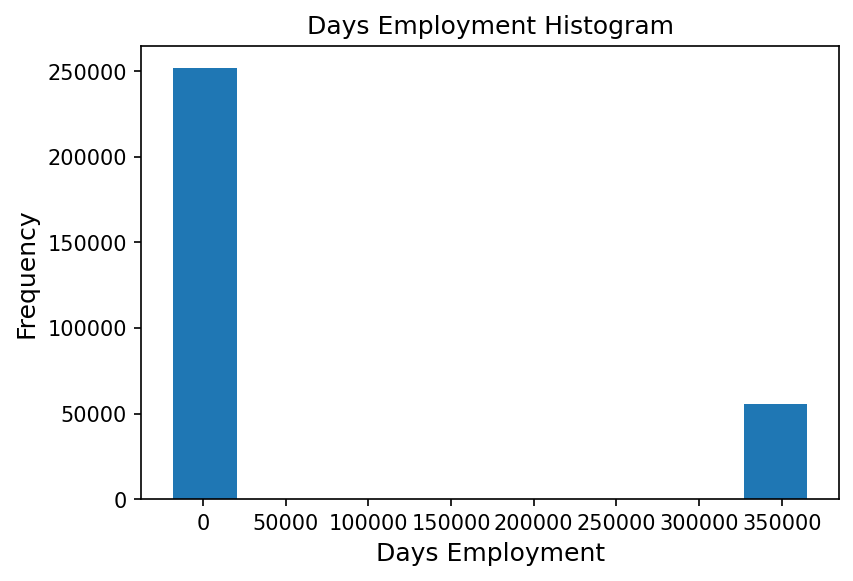

In [17]:
cred_risk_train['DAYS_EMPLOYED'].plot.hist(title = 'Days Employment Histogram')
plt.xlabel('Days Employment')

In [18]:
#checking the subset of anomalous clients to see if they have higher or lower default rates than the rest

anom = cred_risk_train[cred_risk_train['DAYS_EMPLOYED'] == 365243]
non_anom = cred_risk_train[cred_risk_train['DAYS_EMPLOYED'] != 365253]
print('The non-anomalies default on %0.2f%% of loans' % (100*non_anom['TARGET'].mean()))
print('The anomalies default on %0.2f%% of loans' % (100*anom['TARGET'].mean()))
print('There are %d anomalous days of employment' % len(anom))

The non-anomalies default on 8.07% of loans
The anomalies default on 5.40% of loans
There are 55374 anomalous days of employment


Note** Anomalous have a lower default rate, it seems like they are samples of value. Can use imputation to fill them with nan.

Text(0.5, 0, 'Days Employment')

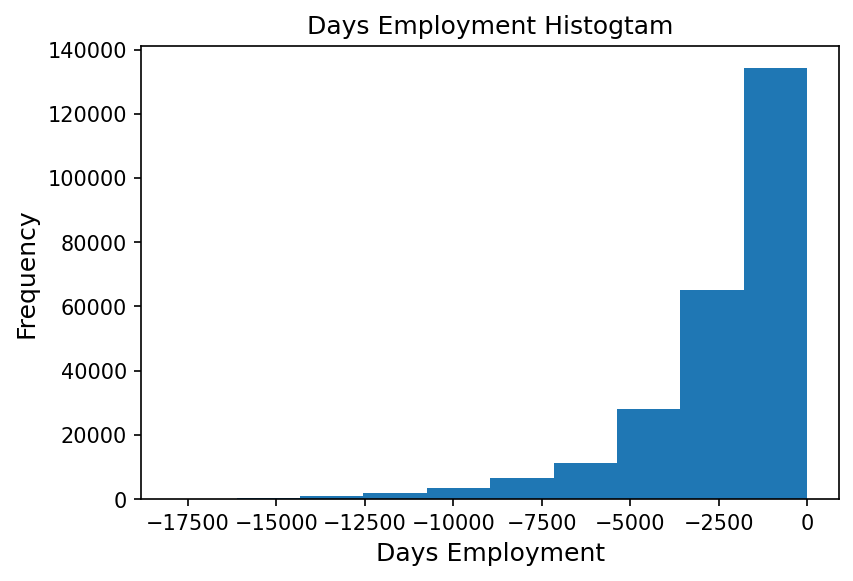

In [19]:
#create an anomalous flag column
cred_risk_train['DAYS_EMPLOYED_ANOM'] = cred_risk_train['DAYS_EMPLOYED'] == 365243

#Replace the anomalous values with nan
cred_risk_train['DAYS_EMPLOYED'].replace({365243: np.nan}, inplace = True)

cred_risk_train['DAYS_EMPLOYED'].plot.hist(title = 'Days Employment Histogtam')
plt.xlabel('Days Employment')

In [20]:
cred_risk_test['DAYS_EMPLOYED_ANOM'] = cred_risk_test['DAYS_EMPLOYED'] == 365243
cred_risk_test['DAYS_EMPLOYED'].replace({365243: np.nan}, inplace = True)

print('There are %d anomalies in the test data out of %d entries' % (cred_risk_test['DAYS_EMPLOYED_ANOM'].sum(), len(cred_risk_test)))

There are 9274 anomalies in the test data out of 48744 entries


##Correlations
Now that we have dealt with the categorical variables and the outliers, let's continue with the EDA. One way to try and understand the data is by looking for correlations between the features and the target. We can calculate the Pearson correlation coefficient between every variable and the target using the .corr dataframe method.

The correlation coefficient is not the greatest method to represent "relevance" of a feature, but it does give us an idea of possible relationships within the data. Some general interpretations of the absolute value of the correlation coefficent are:

.00-.19 “very weak” &nbsp;

.20-.39 “weak” &nbsp;

.40-.59 “moderate”

.60-.79 “strong”

.80-1.0 “very strong”


In [21]:
#Find correlations with target and sort

correlations = cred_risk_train.corr()['TARGET'].sort_values()

#Display Correlations
print('Most Positive Correlations: \n', correlations.tail(15))
print('\nMost Negative Correlations: \n',correlations.head(15))

Most Positive Correlations: 
 OCCUPATION_TYPE_Laborers                             0.043019
FLAG_DOCUMENT_3                                      0.044346
REG_CITY_NOT_LIVE_CITY                               0.044395
FLAG_EMP_PHONE                                       0.045982
NAME_EDUCATION_TYPE_Secondary / secondary special    0.049824
REG_CITY_NOT_WORK_CITY                               0.050994
DAYS_ID_PUBLISH                                      0.051457
CODE_GENDER_M                                        0.054713
DAYS_LAST_PHONE_CHANGE                               0.055218
NAME_INCOME_TYPE_Working                             0.057481
REGION_RATING_CLIENT                                 0.058899
REGION_RATING_CLIENT_W_CITY                          0.060893
DAYS_EMPLOYED                                        0.074958
DAYS_BIRTH                                           0.078239
TARGET                                               1.000000
Name: TARGET, dtype: float64

Most Negat

DAYS_BIRTH is the most positive correlation

Looking at documentation, DAYS_BIRTH is client age in days at time of loan - expressed in negative days. The correlation is positive, but the value of this feature is actually negative - meaning as the client gets older, they are less likely to default on their loan (target == 0).

Let's take the abs value of the feature, then the correlation will be negative.

##Effect of age on repayment

In [22]:
#Find the correlation of the positive days since birth and target

cred_risk_train['DAYS_BIRTH'] = abs(cred_risk_train['DAYS_BIRTH'])
cred_risk_train['DAYS_BIRTH'].corr(cred_risk_train['TARGET'])

-0.07823930830982709

As the client gets older, there is a negative linear relationship with TARGET. Meaning as clients get older, they tend to repay thier loans on time more often.

Let's look at this variable. First making a histgram of age. We put x axis in years to make plot more understandable

Text(0, 0.5, 'Count')

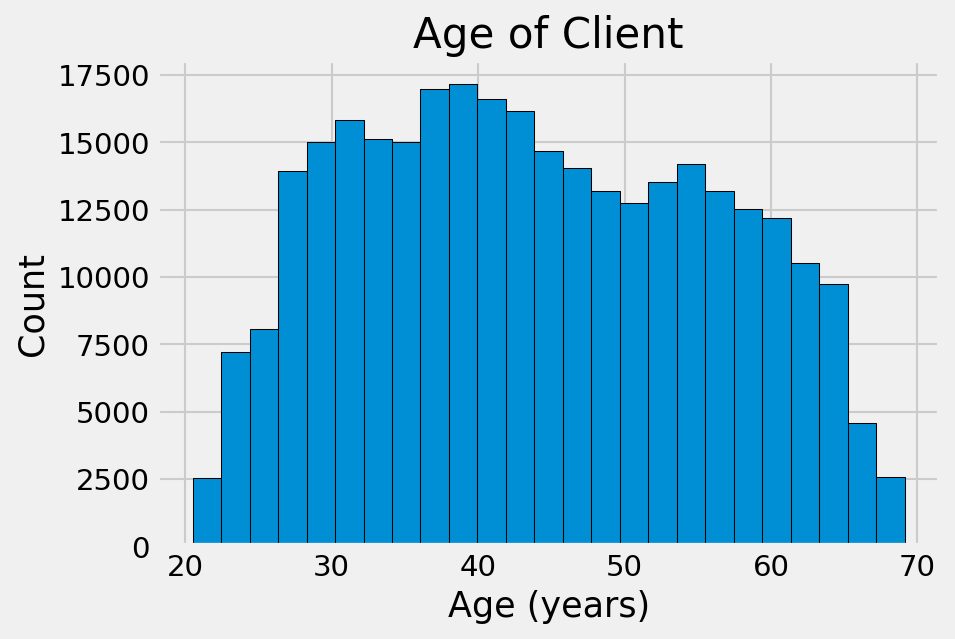

In [23]:
#Set style of plots
plt.style.use('fivethirtyeight')

#Plot the dist. of ages in years
plt.hist(cred_risk_train['DAYS_BIRTH']/365, edgecolor = 'k', bins = 25)
plt.title('Age of Client')
plt.xlabel('Age (years)')
plt.ylabel('Count')

By itself, the distribution of age does not tell us much other than that there are no outliers as all the ages are reasonable. To visualize the effect of the age on the target, we will next make a kernel density estimation plot (KDE) colored by the value of the target. A kernel density estimate plot shows the distribution of a single variable and can be thought of as a smoothed histogram (it is created by computing a kernel, usually a Gaussian, at each data point and then averaging all the individual kernels to develop a single smooth curve). We will use the seaborn kdeplot for this graph.

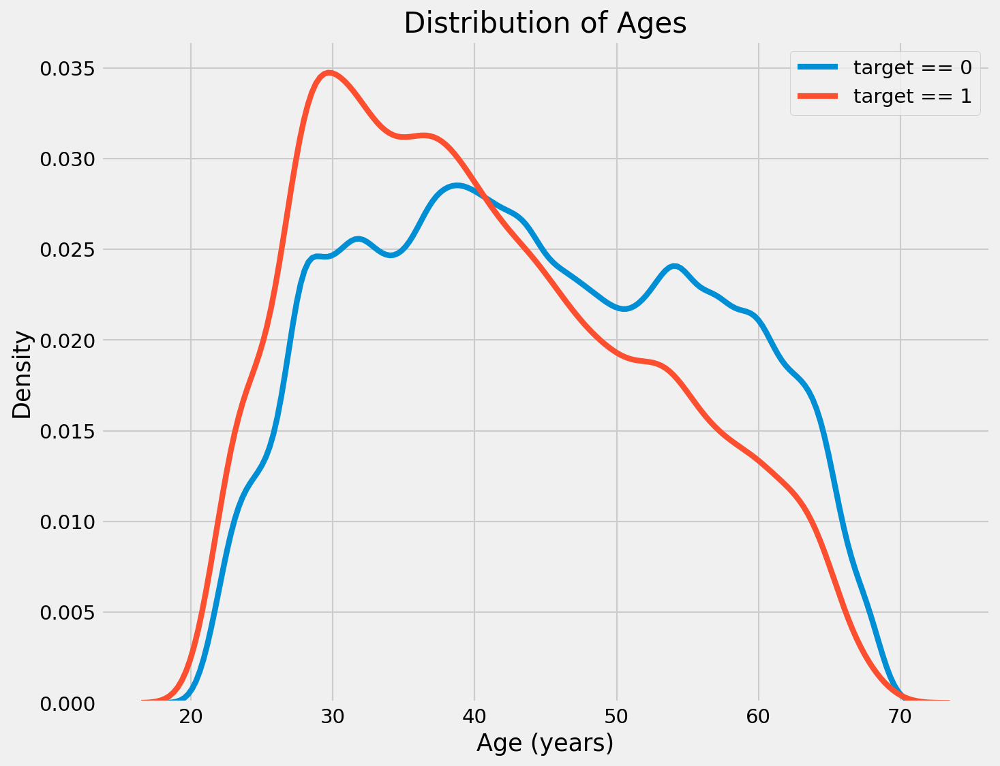

In [24]:
plt.figure(figsize=(10,8))

#KDE plot of loans that were repaid on time
sns.kdeplot(cred_risk_train.loc[cred_risk_train['TARGET']==0, 'DAYS_BIRTH']/365, label = 'target == 0')

#KDE plot of loans which were not repaid on time
sns.kdeplot(cred_risk_train.loc[cred_risk_train['TARGET']==1, 'DAYS_BIRTH']/365, label = 'target == 1')

#labeling of plot
plt.xlabel('Age (years)')
plt.ylabel('Density')
plt.title('Distribution of Ages')
plt.legend()

The target == 1 curve skews towards the younger end of the range. Although this is not a significant correlation (-0.07 correlation coefficient), this variable is likely going to be useful in a machine learning model because it does affect the target. Let's look at this relationship in another way: average failure to repay loans by age bracket.

To make this graph, first we cut the age category into bins of 5 years each. Then, for each bin, we calculate the average value of the target, which tells us the ratio of loans that were not repaid in each age category.

In [25]:
#Age information into a seperate dataframe

age_data = cred_risk_train[['TARGET', 'DAYS_BIRTH']]
age_data['YEARS_BIRTH'] = age_data['DAYS_BIRTH'] / 365

#Bin the age data
age_data['YEARS_BINNED'] = pd.cut(age_data['YEARS_BIRTH'], bins = np.linspace(20,70, num =11))

age_data.head(10)

,TARGET,DAYS_BIRTH,YEARS_BIRTH,YEARS_BINNED
0,1,9461,25.920548,"(25.0, 30.0]"
1,0,16765,45.931507,"(45.0, 50.0]"
2,0,19046,52.180822,"(50.0, 55.0]"
3,0,19005,52.068493,"(50.0, 55.0]"
4,0,19932,54.608219,"(50.0, 55.0]"
5,0,16941,46.413699,"(45.0, 50.0]"
6,0,13778,37.747945,"(35.0, 40.0]"
7,0,18850,51.643836,"(50.0, 55.0]"
8,0,20099,55.065753,"(55.0, 60.0]"
9,0,14469,39.641096,"(35.0, 40.0]"


In [26]:
#Group by bin and calculate averages
age_groups = age_data.groupby('YEARS_BINNED').mean()
age_groups

,TARGET,DAYS_BIRTH,YEARS_BIRTH
YEARS_BINNED,,,
"(20.0, 25.0]",0.123036,8532.795625,23.377522
"(25.0, 30.0]",0.111436,10155.219250,27.822518
"(30.0, 35.0]",0.102814,11854.848377,32.479037
"(35.0, 40.0]",0.089414,13707.908253,37.555913
"(40.0, 45.0]",0.078491,15497.661233,42.459346
"(45.0, 50.0]",0.074171,17323.900441,47.462741
"(50.0, 55.0]",0.066968,19196.494791,52.593136
"(55.0, 60.0]",0.055314,20984.262742,57.491131
"(60.0, 65.0]",0.052737,22780.547460,62.412459


Text(0.5, 1.0, 'Failure to Repay by Age Group')

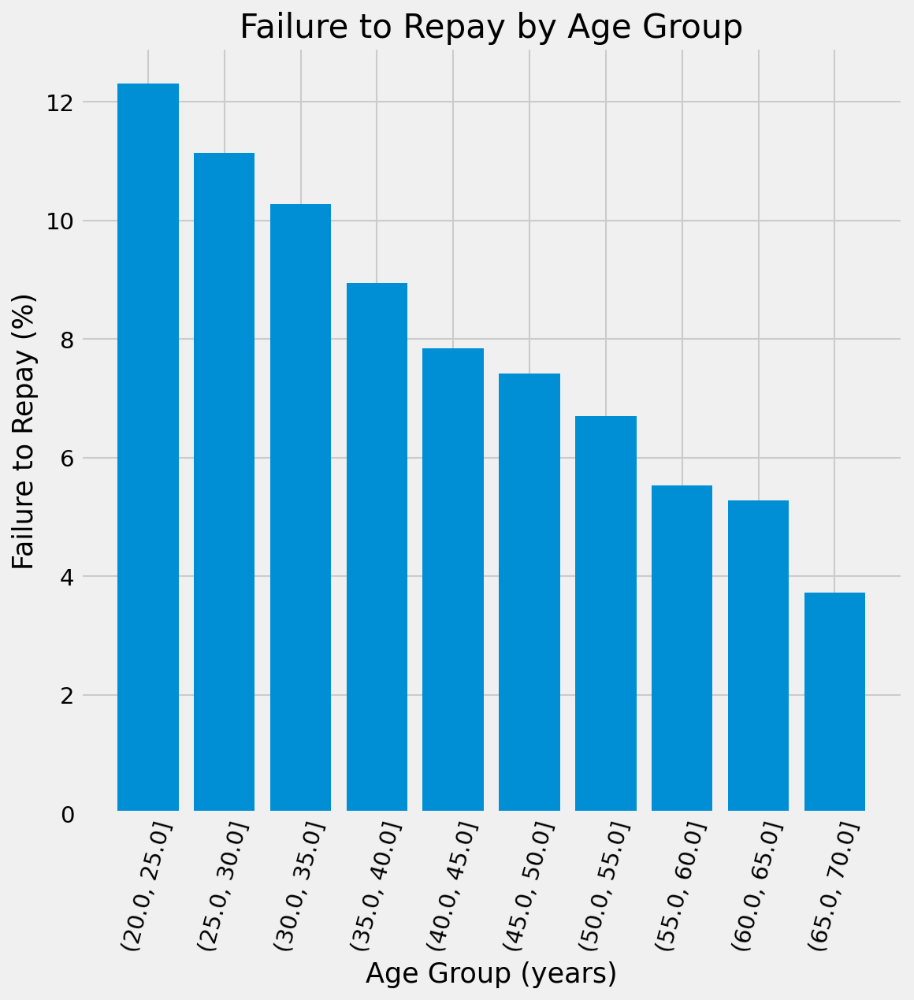

In [27]:
plt.figure(figsize=(8,8))

#graph the age bins and the average of the target as a bar plot
plt.bar(age_groups.index.astype(str), 100*age_groups['TARGET'])

#Plot labeling
plt.xticks(rotation = 75)
plt.xlabel('Age Group (years)')
plt.ylabel('Failure to Repay (%)')
plt.title('Failure to Repay by Age Group')

There is a clear trend: younger applicants are more likely to not repay the loan! The rate of failure to repay is above 10% for the youngest three age groups and beolow 5% for the oldest age group.

This is information that could be directly used by the bank: because younger clients are less likely to repay the loan, maybe they should be provided with more guidance or financial planning tips. This does not mean the bank should discriminate against younger clients, but it would be smart to take precautionary measures to help younger clients pay on time.

##Exterior Sources
The three variables with the strongest negative correlations with the target are: EXT_SOURCE_1; EXT_SOURCE_2; EXT_SOURCE_3

According to documentation, these features represent a "normalized score from external data source". This may mean that it is some sort of cumulative credit rating made using numerous Sources. (so let's check them out)

First we can show correlations of EXT_SOURCE features with the target and with each other

In [28]:
#Extract the EXT_SOURCE variables and show correlations
ext_data = cred_risk_train[['TARGET', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH']]
ext_data_corrs = ext_data.corr()

ext_data_corrs

,TARGET,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,DAYS_BIRTH
TARGET,1.000000,-0.155317,-0.160472,-0.178919,-0.078239
EXT_SOURCE_1,-0.155317,1.000000,0.213982,0.186846,0.600610
EXT_SOURCE_2,-0.160472,0.213982,1.000000,0.109167,0.091996
EXT_SOURCE_3,-0.178919,0.186846,0.109167,1.000000,0.205478
DAYS_BIRTH,-0.078239,0.600610,0.091996,0.205478,1.000000


Text(0.5, 1.0, 'Correlation Heatmap')

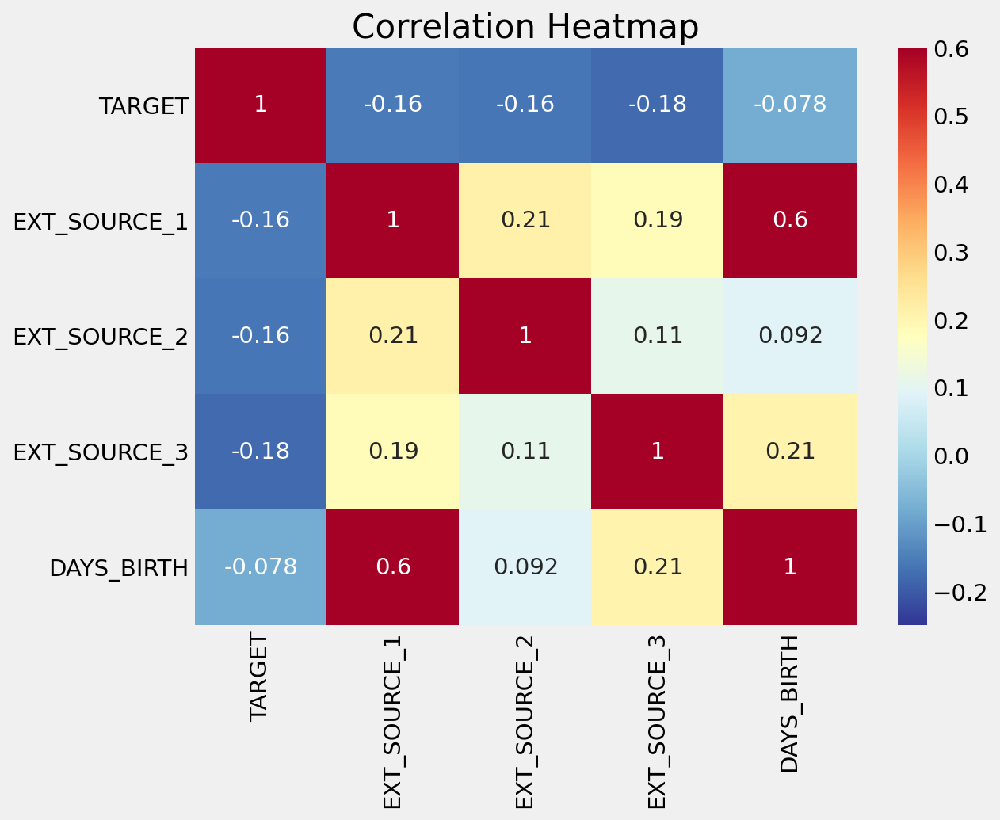

In [29]:
plt.figure(figsize=(8,6))

#Heatmap of correlations
sns.heatmap(ext_data_corrs, cmap=plt.cm.RdYlBu_r, vmin = -0.25, annot= True, vmax=0.6)

plt.title('Correlation Heatmap')

All three EXT_SOURCE features have negative correlations with the target, indicating that as the value of EXT_SOURCE increases, the client is more likely to repay the loan. We can also see that DAYS_BIRTH is positively correlated with EXT_SOURCE_1 indicating that maybe one of the factors in this score is client age.

Next we cal look at the distribution of each of these features colored by value of the target. This will let us visualize the effect of this variable on the target.

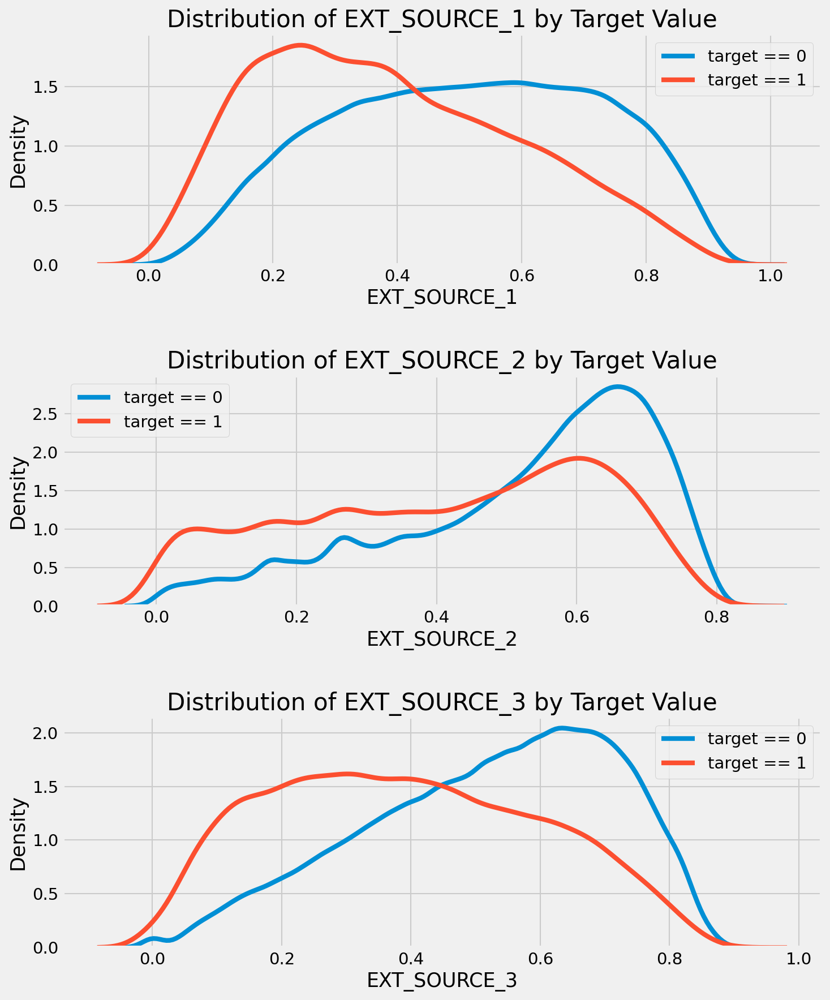

In [30]:
plt.figure(figsize = (10,12))

#iterate through the sources
for i, source in enumerate(['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3']):
    #create a new subplot for each source
    plt.subplot(3, 1, i + 1)

    #plot repaid loans
    sns.kdeplot(cred_risk_train.loc[cred_risk_train['TARGET'] == 0, source], label = 'target == 0')
    #plot loans that were not repaid
    sns.kdeplot(cred_risk_train.loc[cred_risk_train['TARGET'] == 1, source], label = 'target == 1')

    #label the plots
    plt.title('Distribution of %s by Target Value' % source)
    plt.xlabel('%s' % source)
    plt.ylabel('Density')
    plt.legend()

    plt.tight_layout(h_pad = 2.5)

EXT_SOURCE_3 displays the greatest difference between the values of the target. We can clearly see that this feature has some relationship to the likelihood of an applicant to repay a loan.

The relationship is not very strong (infact they are all considered very weak), but these variables will still be useful for a machine learning model to predict whether or not an applicant will repay a loan on time.

##Pairs Plot

As a final exploratory plot, we can make a pairs plot of the EXT_SOURCE variables and the DAYS_BIRTH variable. The Pairs Plot is a great exploration tool because it lets us see realtionships between multiple pairs of variables as well as distributions of single variables. Here we are using the seaborn visualization library and the PairGrid function to create a Pairs Plot with scatterplots on the upper triangle, histograms on the diabonal, and 2d Kernel Density Plots and correlations coefficients on the lower triangle.


Text(0.5, 1.05, 'Ext Source and Age Features Pairs Plot')

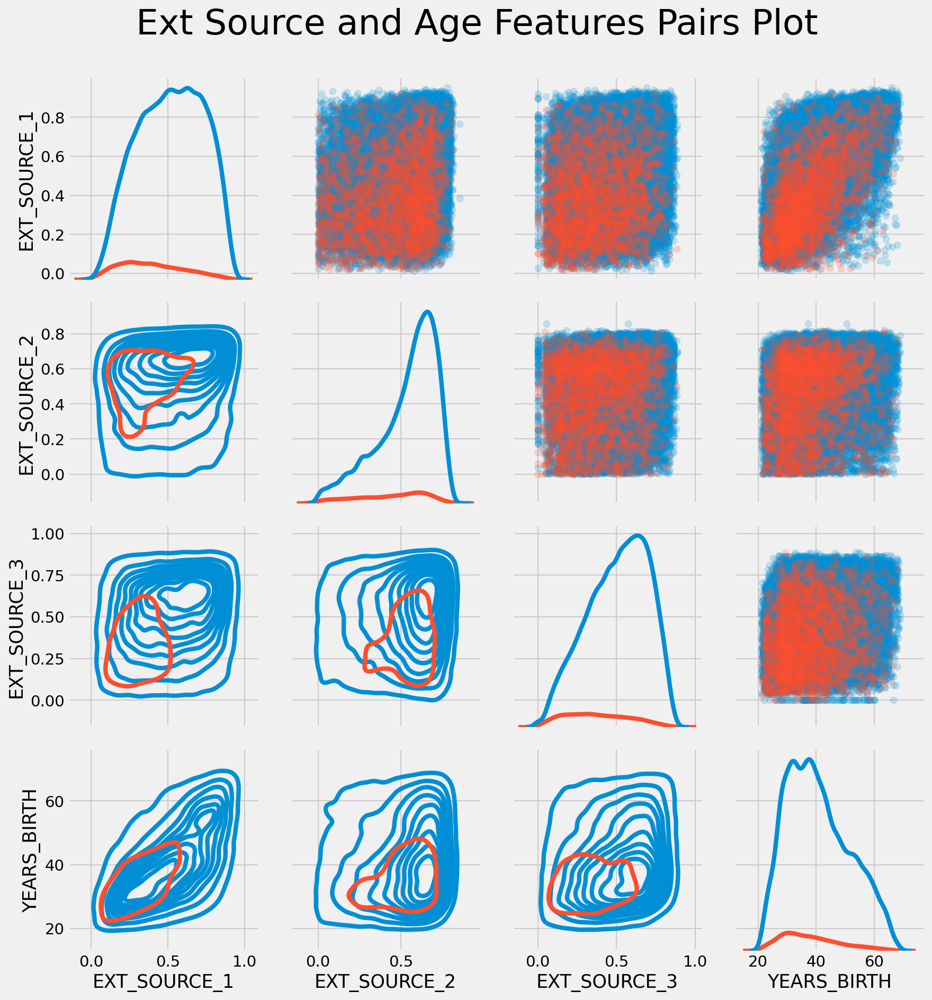

In [31]:
#copy the data for plotting
#plot_data = cred_risk_train[['TARGET', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3']].copy()
plot_data = ext_data.drop(columns = ['DAYS_BIRTH']).copy()


#Add in the age of the client in years
plot_data['YEARS_BIRTH'] = age_data['YEARS_BIRTH']

#Drop na values and limit to first 100000 rows
plot_data = plot_data.dropna().loc[:100000, :]

#Function to calculate correlation coeeficient between two columns
def corr_func(x,y, **kwargs):
    r = np.corrcoef(x,y)[0][1]
    ax = plt.gca()
    ax.annotate("r = {:.2f}".format(r),
     xy=(.2, .8), 
     xycoords=ax.transAxes, 
     size=20)

#create the pairgrid object
grid = sns.PairGrid(data = plot_data, size=3, diag_sharey = False, hue='TARGET', vars=[x for x in list(plot_data.columns) if x != 'TARGET'])

#Upper is a scatterplot
grid.map_upper(plt.scatter, alpha = 0.2)

#Diagonal is a histogram
grid.map_diag(sns.kdeplot)

#Bottom is a density plot
grid.map_lower(sns.kdeplot, cmap = plt.cm.OrRd_r)

plt.suptitle('Ext Source and Age Features Pairs Plot', size = 32, y = 1.05)




**Note*: graphs failing. need to redo**

In this plot, the red indicates loans that were not repaid and the blue are loans that are paid. We can see the different relationships within the data. There does appear to be a moderate positive linear relationship between the EXT_SOURCE_1 and the DAYS_BIRTH (or equivalently YEARS_BIRTH), indicating that this feature may take into account the age of the client.

##Feature Engineering

Feature engineering refers to a general process and can involve both feature construction: adding new features from existing data, and feature selection - choosing only the most important features or other methods of dimensionality reduction. There are many techniques we can use to both create features and select features.

Below shows two simple feature construction methods:
- polynomial features
- Domain knowledge features

##Polynomial Features

One simple feature construction method is called polynomial features. In this method, we make features that are powers of existing features as well as interaction terms between existing features. For example, we can create variables EXT_SOURCE_1^2 and EXT_SOURCE_2^2 and also variables such as EXT_SOURCE_1 x EXT_SOURCE_2, EXT_SOURCE_1 x EXT_SOURCE_2^2, EXT_SOURCE_1^2 x EXT_SOURCE_2^2, and so on. These features that are a combination of multiple individual variables are called interaction terms because they capture the interactions between variables. In other words, while two variables by themselves may not have a strong influence on the target, combining them together into a single interaction variable might show a relationship with the target. Interaction terms are commonly used in statistical models to capture the effects of multiple variables, but I do not see them used as often in machine learning. Nonetheless, we can try out a few to see if they might help our model to predict whether or not a client will repay a loan.

Jake VanderPlas writes about polynomial features in his excellent book Python for Data Science for those who want more information.

In the following code, we create polynomial features using the EXT_SOURCE variables and the DAYS_BIRTH variable. Scikit-Learn has a useful class called PolynomialFeatures that creates the polynomials and the interaction terms up to a specified degree. We can use a degree of 3 to see the results (when we are creating polynomial features, we want to avoid using too high of a degree, both because the number of features scales exponentially with the degree, and because we can run into problems with overfitting).


In [32]:
#making a new dataframe for polynomial features
poly_features = cred_risk_train[['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH', 'TARGET']]
poly_features_test = cred_risk_test[['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH']]

#imputer for handling missing values
from sklearn.impute import SimpleImputer

imputer = SimpleImputer(strategy = 'median')
#imputer_test = SimpleImputer(strategy = 'median') #note made two imputers (this may not be correct - guide only showed one)

poly_target = poly_features['TARGET']
poly_features = poly_features.drop(columns = ['TARGET']) #note need to drop target to make train and test match each other

#need to impute missing values
poly_features = imputer.fit_transform(poly_features)
poly_features_test = imputer.fit_transform(poly_features_test)

from sklearn.preprocessing import PolynomialFeatures

#create the polynomial object with specified degree
poly_transformer = PolynomialFeatures(degree = 3)

In [33]:
#train the polynomial features
poly_transformer.fit(poly_features)

#transform the features
poly_features = poly_transformer.transform(poly_features)
poly_features_test = poly_transformer.transform(poly_features_test)

print('Polynomial Features shape: ', poly_features.shape)

Polynomial Features shape:  (307511, 35)


This creates a considerable number of new features. To get the names we have to use the polynomial features get_feature_names method.

In [34]:
poly_transformer.get_feature_names(input_features=['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH'])#[:15]   #will shorten to 15 with [:15]

['1',
 'EXT_SOURCE_1',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'DAYS_BIRTH',
 'EXT_SOURCE_1^2',
 'EXT_SOURCE_1 EXT_SOURCE_2',
 'EXT_SOURCE_1 EXT_SOURCE_3',
 'EXT_SOURCE_1 DAYS_BIRTH',
 'EXT_SOURCE_2^2',
 'EXT_SOURCE_2 EXT_SOURCE_3',
 'EXT_SOURCE_2 DAYS_BIRTH',
 'EXT_SOURCE_3^2',
 'EXT_SOURCE_3 DAYS_BIRTH',
 'DAYS_BIRTH^2',
 'EXT_SOURCE_1^3',
 'EXT_SOURCE_1^2 EXT_SOURCE_2',
 'EXT_SOURCE_1^2 EXT_SOURCE_3',
 'EXT_SOURCE_1^2 DAYS_BIRTH',
 'EXT_SOURCE_1 EXT_SOURCE_2^2',
 'EXT_SOURCE_1 EXT_SOURCE_2 EXT_SOURCE_3',
 'EXT_SOURCE_1 EXT_SOURCE_2 DAYS_BIRTH',
 'EXT_SOURCE_1 EXT_SOURCE_3^2',
 'EXT_SOURCE_1 EXT_SOURCE_3 DAYS_BIRTH',
 'EXT_SOURCE_1 DAYS_BIRTH^2',
 'EXT_SOURCE_2^3',
 'EXT_SOURCE_2^2 EXT_SOURCE_3',
 'EXT_SOURCE_2^2 DAYS_BIRTH',
 'EXT_SOURCE_2 EXT_SOURCE_3^2',
 'EXT_SOURCE_2 EXT_SOURCE_3 DAYS_BIRTH',
 'EXT_SOURCE_2 DAYS_BIRTH^2',
 'EXT_SOURCE_3^3',
 'EXT_SOURCE_3^2 DAYS_BIRTH',
 'EXT_SOURCE_3 DAYS_BIRTH^2',
 'DAYS_BIRTH^3']

There are 35 features with individual features raised to powers up to degree 3 and interaction terms. Now, we can see whether any of these new features are correlated with the target.

In [35]:
#create a dataframe of the features

poly_features = pd.DataFrame(poly_features, columns = poly_transformer.get_feature_names(['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH']))

#add in the target
poly_features['TARGET'] = poly_target

#find correlations with the target
poly_corrs = poly_features.corr()['TARGET'].sort_values()

#display most negative and most positve features
print(poly_corrs.head(10))
print(poly_corrs.tail(5))

EXT_SOURCE_2 EXT_SOURCE_3                -0.193939
EXT_SOURCE_1 EXT_SOURCE_2 EXT_SOURCE_3   -0.189605
EXT_SOURCE_2 EXT_SOURCE_3 DAYS_BIRTH     -0.181283
EXT_SOURCE_2^2 EXT_SOURCE_3              -0.176428
EXT_SOURCE_2 EXT_SOURCE_3^2              -0.172282
EXT_SOURCE_1 EXT_SOURCE_2                -0.166625
EXT_SOURCE_1 EXT_SOURCE_3                -0.164065
EXT_SOURCE_2                             -0.160295
EXT_SOURCE_2 DAYS_BIRTH                  -0.156873
EXT_SOURCE_1 EXT_SOURCE_2^2              -0.156867
Name: TARGET, dtype: float64
DAYS_BIRTH     -0.078239
DAYS_BIRTH^2   -0.076672
DAYS_BIRTH^3   -0.074273
TARGET          1.000000
1                    NaN
Name: TARGET, dtype: float64


Several of the new variables have a greater (in terms of absolute magnitude) correlation with the target than the original features. When we build machine learning models, we can try with and without these features to determine if they actually help the model learn.

We will add these features to a copy of the training and testing data and then evaluate models with and without the features. Many times in machine learning, the only way to know if an approach will work is to try it out!

In [36]:
#Put test features into dataframe
poly_features_test = pd.DataFrame(poly_features_test, columns = poly_transformer.get_feature_names(['EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH']))

#merge polynomial features into training dataframe
poly_features['SK_ID_CURR'] = cred_risk_train['SK_ID_CURR']
cred_risk_train_poly = cred_risk_train.merge(poly_features, on = 'SK_ID_CURR', how = 'left')

#merge polynomial features into testing dataframe
poly_features_test['SK_ID_CURR'] = cred_risk_test['SK_ID_CURR']
cred_risk_test_poly = cred_risk_test.merge(poly_features_test, on = 'SK_ID_CURR', how = 'left')

#align the dataframes
cred_risk_train_poly, cred_risk_test_poly = cred_risk_train_poly.align(cred_risk_test_poly, join = 'inner', axis = 1)

#printing out the new shapes
print('Training data with polynomial features shape: ', cred_risk_train_poly.shape)
print('Testing data with polynomial features shape: ', cred_risk_test_poly.shape)


Training data with polynomial features shape:  (307511, 275)
Testing data with polynomial features shape:  (48744, 275)


##Domain Knowledge Features
Creating features that attempt to capture what we think may be important for telling wheter a client will default on a loan.

Example will use five features:
- CREDIT_INCOME_PERCENT: precentage of credit amount relative to a client's income
- ANNUITY_INCOME_PERCENT: the percentage of the loan annuity relative to a client's income
- CREDIT_TERM: the length of the payment in months (since the nnuit is the monthly amout due)
- DAYS_EMPLOYED_PERCENT: the percentage of the days employed relative to the clients age

In [37]:
cred_risk_train_domain = cred_risk_train.copy()
cred_risk_test_domain = cred_risk_test.copy()

cred_risk_train_domain['CREDIT_INCOME_PERCENT'] = cred_risk_train_domain['AMT_CREDIT'] / cred_risk_train_domain['AMT_INCOME_TOTAL']

cred_risk_train_domain['ANNUITY_INCOME_PERCENT'] = cred_risk_train_domain['AMT_ANNUITY'] / cred_risk_train_domain['AMT_INCOME_TOTAL']

cred_risk_train_domain['CREDIT_TERM'] = cred_risk_train_domain['AMT_ANNUITY'] / cred_risk_train_domain['AMT_CREDIT']

cred_risk_train_domain['DAYS_EMPLOYED_PERCENT'] = cred_risk_train_domain['DAYS_EMPLOYED'] / cred_risk_train_domain['DAYS_BIRTH']

In [38]:
cred_risk_test_domain['CREDIT_INCOME_PERCENT'] = cred_risk_test_domain['AMT_CREDIT'] / cred_risk_test_domain['AMT_INCOME_TOTAL']

cred_risk_test_domain['ANNUITY_INCOME_PERCENT'] = cred_risk_test_domain['AMT_ANNUITY'] / cred_risk_test_domain['AMT_INCOME_TOTAL']

cred_risk_test_domain['CREDIT_TERM'] = cred_risk_test_domain['AMT_ANNUITY'] / cred_risk_test_domain['AMT_CREDIT']

cred_risk_test_domain['DAYS_EMPLOYED_PERCENT'] = cred_risk_test_domain['DAYS_EMPLOYED']/ cred_risk_test_domain['DAYS_BIRTH']

##Visualize new variables

We should explore these **domain knowledge** variables visually in a graph. For all of these, we will make the same KDE plot colored by the value of the TARGET

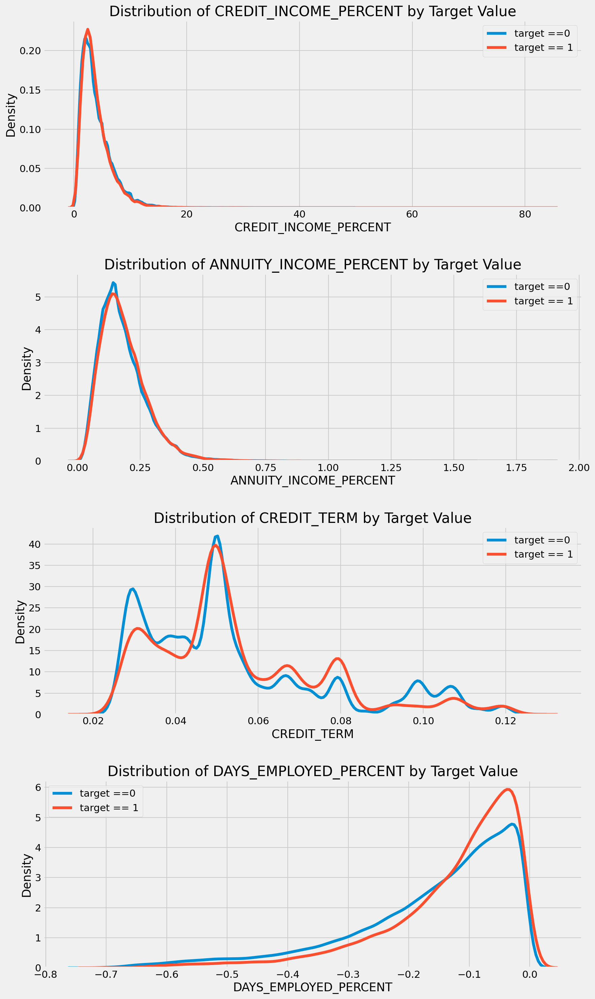

In [39]:
plt.figure(figsize = (12,20))

#iterate through the new features
for i, feature in enumerate(['CREDIT_INCOME_PERCENT', 'ANNUITY_INCOME_PERCENT', 'CREDIT_TERM', 'DAYS_EMPLOYED_PERCENT']):
    #create a new subplot for each source
    plt.subplot(4,1, i+1)
    #plot repaud loans
    sns.kdeplot(cred_risk_train_domain.loc[cred_risk_train_domain['TARGET'] == 0, feature], label = 'target ==0')
    #plot loans that were not repaid
    sns.kdeplot(cred_risk_train_domain.loc[cred_risk_train_domain['TARGET']==1, feature], label = 'target == 1')

    #label the plots
    plt.title('Distribution of %s by Target Value' % feature)
    plt.xlabel('%s' % feature)
    plt.ylabel('Density')
    plt.legend()

plt.tight_layout(h_pad = 2.5)


It's hard to say if the new features will be useful. the only way to be sure is to try them out

##Baseline

For a naive baseline, we could guess the same value for all examples on the testing set. We are asked to predict the probability of not repaying the loan, so if we are entirely unsure, we would guess 0.5 for all observations on the test set. This will get us a Reciever Operating Characteristic Area Under the Curve (AUC ROC) of 0.5 in the competition (random guessing on a classification task will score a 0.5).

Since we already know what score we are going to get, we don't really need to make a naive baseline guess. Let's use a slightly more sophisticated model for our actual baseline: Logistic Regression.



##Logistic Regression Implementation

Here we will focus on implmenting the model. 

To get a baseline, we will use all of the features after encoding the categoriacal variables. We will preprocess the data by filling in the missing values (imputation) and normalizing the range of features (feature scaling). The following code performs both of these preprocessing steps:

In [40]:
#print(train.head())

# features = list(train.columns)

# pd.Series(features).str.count

In [41]:
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from sklearn.impute import SimpleImputer

#Drop the target from the training data
if 'TARGET' in cred_risk_train:
    train  = cred_risk_train.drop(columns = 'TARGET')
else:
    train = cred_risk_train.copy()

#Feature names
features = list(train.columns)

#pd.Series(features).str.count

#copy of the testing data
test = cred_risk_test.copy()

#we see above that some columns (eg. CODE_GENDER) are non-numeric
#using label encoder to make its values numeric
# mapping_gender = {
#     'M':0,
#     'F':1
# }
# cred_risk_train['CODE_GENDER'] = cred_risk_train['CODE_GENDER'].map(mapping_gender)
# print(cred_risk_train.head())
# print(cred_risk_test.head())
# cred_risk_test['CODE_GENDER'] = cred_risk_test['CODE_GENDER'].map(mapping_gender)

# print(cred_risk_train.head())
# print(cred_risk_test.head())
#median imputation of missing values
#simpleImputer cannot imput median, mean, or constant values on non-numeric
imputer = SimpleImputer(strategy = 'median') 

#scale each feature to 0-1
scaler = MinMaxScaler(feature_range= (0,1))

'''
##maybe try using fillna instead of imputer for the cols missing 
for i in enumerate(train.columns):
    train.iloc[i].fillna()


#label encoder to encode string as catergorical int
le = LabelEncoder()
#le.fit_transform(train)
'''
#fit on the training data
imputer.fit(train)

#transform both training and testing data
train = imputer.transform(train)
test = imputer.transform(test)

#repeat with the scaler
scaler.fit(train)
train = scaler.transform(train)
test = scaler.transform(test)

print('Training data shape: ', train.shape)
print('Testing data shape: ', test.shape)

Training data shape:  (307511, 240)
Testing data shape:  (48744, 240)


We will use LogisticRegressionfrom Scikit-Learn for our first model. The only change we will make from the default model settings is to lower the regularization parameter, C, which controls the amount of overfitting (a lower value should decrease overfitting). This will get us slightly better results than the default LogisticRegression, but it still will set a low bar for any future models.

Here we use the familiar Scikit-Learn modeling syntax: we first create the model, then we train the model using .fit and then we make predictions on the testing data using .predict_proba (remember that we want probabilities and not a 0 or 1).

In [42]:
from sklearn.linear_model import LogisticRegression

#make the model with the specified regularization parameter
log_reg = LogisticRegression(C = 0.0001)

#train on the training data
log_reg.fit(train, train_labels)

LogisticRegression(C=0.0001)

In [43]:
#make predictions
#make sure to select the second column only

'''with predict_proba it returns an m x2 array (m == number of observations). The first column is the probablity of target being 0 (loan repaid), the second column is the probability of the target being 1 (loan not repaid).'''

#we want the prob of the loan not repaid (so we will select 2nd column)
log_reg_pred = log_reg.predict_proba(test)[:,1]

In [44]:
submit = cred_risk_test[['SK_ID_CURR']]
submit['PROB_NOT_REPAID'] = log_reg_pred

submit.head()

,SK_ID_CURR,PROB_NOT_REPAID
0,100001,0.078515
1,100005,0.137926
2,100013,0.082194
3,100028,0.080921
4,100038,0.132618


In [45]:
from sklearn.ensemble import RandomForestClassifier

#make the random forest classifier
random_forest = RandomForestClassifier(n_estimators = 100, random_state = 50, verbose = 1, n_jobs = -1)

In [46]:
#train on the training data
random_forest.fit(train, train_labels)

#exact feature importances
feature_importance_values = random_forest.feature_importances_
feature_importances = pd.DataFrame({'feature': features, 'importance': feature_importance_values})

#make predictions on the tests data
predictions = random_forest.predict_proba(test)[:,1]

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   27.8s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  1.2min finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.3s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.8s finished


In [47]:
submit = cred_risk_test[['SK_ID_CURR']]
submit['TARGET'] = predictions

submit.head()

,SK_ID_CURR,TARGET
0,100001,0.13
1,100005,0.21
2,100013,0.05
3,100028,0.14
4,100038,0.20


##Make Predictions using Engineered Features

The only way to see if the Polynomial Features and Domain Knowledge improved the model is to train a test model on these features. We can compare the submission perforamce to that for the model without these features to guage the effect of our feature engineering

In [48]:
poly_features_names = list(cred_risk_train_poly.columns)

#impute the polynomial features
imputer = SimpleImputer(strategy = 'median')

poly_features = imputer.fit_transform(cred_risk_train_poly)
poly_features_test = imputer.fit_transform(cred_risk_test_poly)

#scale the polynomial features
scaler = MinMaxScaler(feature_range = (0,1))

poly_features = scaler.fit_transform(poly_features)
poly_features_test = scaler.transform(poly_features_test)

random_forest_poly = RandomForestClassifier(n_estimators = 100, random_state = 50, verbose = 1, n_jobs = -1)

In [49]:
#train on the training data
random_forest_poly.fit(poly_features, train_labels)

#make predictions on the test data
predictions = random_forest_poly.predict_proba(poly_features_test)[:,1]

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   43.6s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  1.9min finished
[Parallel(n_jobs=8)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done  34 tasks      | elapsed:    0.1s
[Parallel(n_jobs=8)]: Done 100 out of 100 | elapsed:    0.3s finished


In [53]:
valid_score = random_forest_poly.best_score_['valid']['auc']

AttributeError: 'RandomForestClassifier' object has no attribute 'best_score_'

In [50]:
submit = cred_risk_test[['SK_ID_CURR']]
submit['TARGET'] = predictions

submit.head()

,SK_ID_CURR,TARGET
0,100001,0.37
1,100005,0.36
2,100013,0.34
3,100028,0.29
4,100038,0.38


#note my scoing is not coming out the same (fix this)

This model scored 0.678 when submitted to the competition, exactly the same as that without the engineered features. Given these results, it does not appear that our feature construction helped in this case

##Testing Domain Features

Now we can test the domain features we made by hand

In [51]:
print(cred_risk_train_domain.columns)

#cred_risk_train_domain = cred_risk_train_domain.drop(columns = 'TARGET')

domain_features_names = list (cred_risk_train_domain.columns)

#Impute the domain nominal features
imputer = SimpleImputer(strategy = 'median')

domain_features = imputer.fit_transform(cred_risk_train_domain)
domain_features_test = imputer.fit_transform(cred_risk_test_domain)

random_forest_domain = RandomForestClassifier(n_estimators = 100, random_state = 50, verbose = 1, n_jobs = -1)

#Train on the training data
random_forest_domain.fit(domain_features, train_labels)

#extract feature importances
feature_importance_values_domain = random_forest_domain.feature_importances_
feature_importances_domain = pd.DataFrame({'feature': domain_features_name, 'importance': feature_importance_values_domain})

#make predictions on the test data
predictions = random_forest_domain.predict_proba(domain_features_test)[:,1]

Index(['SK_ID_CURR', 'NAME_CONTRACT_TYPE', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY',
       'CNT_CHILDREN', 'AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY',
       'AMT_GOODS_PRICE', 'REGION_POPULATION_RELATIVE',
       ...
       'WALLSMATERIAL_MODE_Stone, brick', 'WALLSMATERIAL_MODE_Wooden',
       'EMERGENCYSTATE_MODE_No', 'EMERGENCYSTATE_MODE_Yes', 'TARGET',
       'DAYS_EMPLOYED_ANOM', 'CREDIT_INCOME_PERCENT', 'ANNUITY_INCOME_PERCENT',
       'CREDIT_TERM', 'DAYS_EMPLOYED_PERCENT'],
      dtype='object', length=245)
[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   15.6s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:   43.8s finished


NameError: name 'domain_features_name' is not defined

In [ ]:
subm